In [ ]:
!nvidia-smi

Sat Sep 28 06:30:13 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   58C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.102 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 36.5/112.6 GB disk)


In [ ]:
!pip install opencv-python

In [26]:
import cv2
import os
import time
import pandas as pd
from ultralytics import YOLO
# from tracker import *
from google.colab.patches import cv2_imshow
model=YOLO('yolov8s.pt')

In [27]:
import math



class Tracker:
    def __init__(self):
        # Store the center positions of the objects
        self.center_points = {}
        # Keep the count of the IDs
        # each time a new object id detected, the count will increase by one
        self.id_count = 0


    def update(self, objects_rect):
        # Objects boxes and ids
        objects_bbs_ids = []

        # Get center point of new object
        for rect in objects_rect:
            x, y, w, h = rect
            cx = (x + x + w) // 2
            cy = (y + y + h) // 2

            # Find out if that object was detected already
            same_object_detected = False
            for id, pt in self.center_points.items():
                dist = math.hypot(cx - pt[0], cy - pt[1])

                if dist < 35:
                    self.center_points[id] = (cx, cy)
#                    print(self.center_points)
                    objects_bbs_ids.append([x, y, w, h, id])
                    same_object_detected = True
                    break

            # New object is detected we assign the ID to that object
            if same_object_detected is False:
                self.center_points[self.id_count] = (cx, cy)
                objects_bbs_ids.append([x, y, w, h, self.id_count])
                self.id_count += 1

        # Clean the dictionary by center points to remove IDS not used anymore
        new_center_points = {}
        for obj_bb_id in objects_bbs_ids:
            _, _, _, _, object_id = obj_bb_id
            center = self.center_points[object_id]
            new_center_points[object_id] = center

        # Update dictionary with IDs not used removed
        self.center_points = new_center_points.copy()
        return objects_bbs_ids

In [28]:
tracker = Tracker()
count = 0

In [29]:
class_list = ['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven',
              'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']

In [30]:
cap = cv2.VideoCapture('/content/highway_mini.mp4')

In [24]:
down = {}
up = {}
counter_down = []
counter_up = []

red_line_y = 198
blue_line_y = 268
offset = 6

In [31]:
# Create a folder to save frames
if not os.path.exists('detected_frames'):
    os.makedirs('detected_frames')

fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('output.avi', fourcc, 20.0, (1020, 500))


0: 320x640 9 cars, 3 trucks, 12.4ms
Speed: 1.9ms preprocess, 12.4ms inference, 1.5ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   268.701050  174.515228  305.326965  199.400848  0.843476  2.0
1   583.501770  226.544739  638.676025  263.994751  0.783759  2.0
2   613.752380  183.575211  650.472839  206.959152  0.753000  2.0
3   580.134521  113.168236  612.694946  144.720825  0.743348  7.0
4   431.051971  143.814240  454.441132  161.985031  0.732743  2.0
5   356.236511  160.987396  386.729523  182.523773  0.673241  2.0
6   575.293091  149.000046  597.588074  166.394119  0.616677  2.0
7   526.804138  136.425308  546.910400  150.731110  0.469749  2.0
8   616.192200  150.731934  655.698242  171.517853  0.292880  7.0
9   611.869934  139.242447  654.570862  170.131699  0.290499  7.0
10  386.327026  141.752426  410.276947  156.706589  0.266816  2.0
11  622.564209  151.461594  655.857239  170.352356  0.261110  2.0


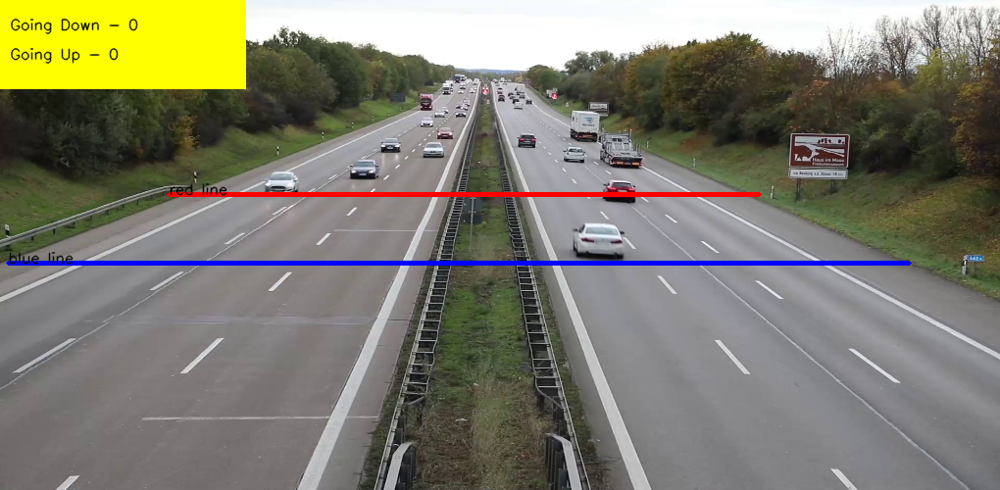


0: 320x640 9 cars, 2 trucks, 12.1ms
Speed: 2.6ms preprocess, 12.1ms inference, 1.8ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   266.303802  176.286438  302.498657  200.838013  0.833862  2.0
1   613.087524  183.047791  647.453125  205.825623  0.825343  2.0
2   581.417603  223.677567  635.500122  260.052704  0.789803  2.0
3   430.608124  144.629669  453.139679  162.312134  0.760401  2.0
4   579.949646  113.379883  612.177673  144.382629  0.721715  7.0
5   354.754974  162.639877  384.708984  183.995590  0.692109  2.0
6   572.754578  148.912994  597.253845  166.048798  0.622714  2.0
7   526.623291  136.067917  546.570862  150.325714  0.533351  2.0
8   611.252136  135.068359  655.502258  169.741669  0.423537  7.0
9   385.650635  142.472870  408.250092  156.754837  0.371854  2.0
10  444.635345  130.766098  464.948242  144.288849  0.251587  2.0


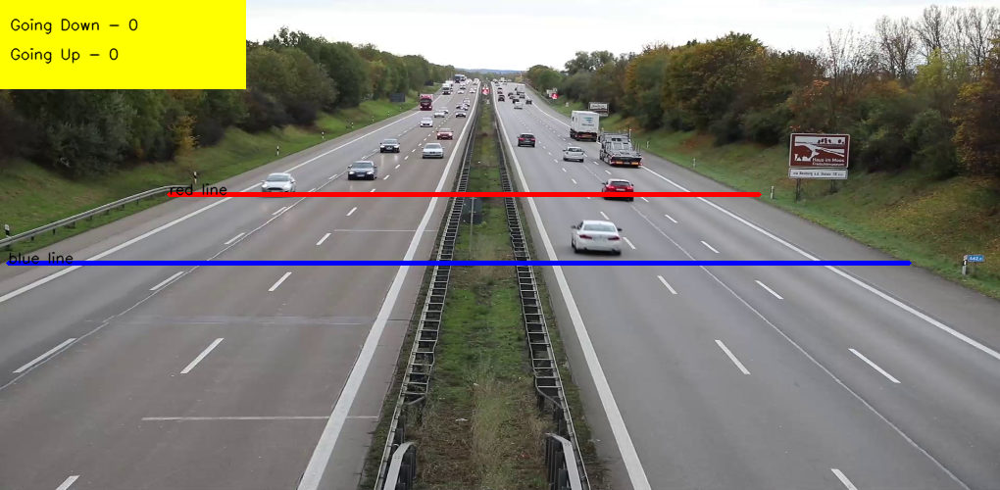


0: 320x640 9 cars, 2 trucks, 12.7ms
Speed: 2.6ms preprocess, 12.7ms inference, 1.7ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   262.200165  177.177032  300.058228  202.433517  0.854600  2.0
1   580.180847  219.809067  632.494446  256.446930  0.825063  2.0
2   611.691650  181.798279  645.801453  203.853378  0.799646  2.0
3   429.584595  144.381378  452.917694  163.019302  0.796661  2.0
4   579.764099  113.061386  612.126465  144.162079  0.677811  7.0
5   352.153290  163.946106  382.454132  185.707794  0.581091  2.0
6   572.736877  148.711609  595.835938  165.264435  0.579780  2.0
7   610.364441  135.477341  654.214111  170.106186  0.508182  7.0
8   526.227844  136.003052  546.453430  149.900711  0.410062  2.0
9   385.494324  141.916824  407.743958  156.538132  0.371203  2.0
10  444.250336  129.828857  464.129395  144.350128  0.279372  2.0


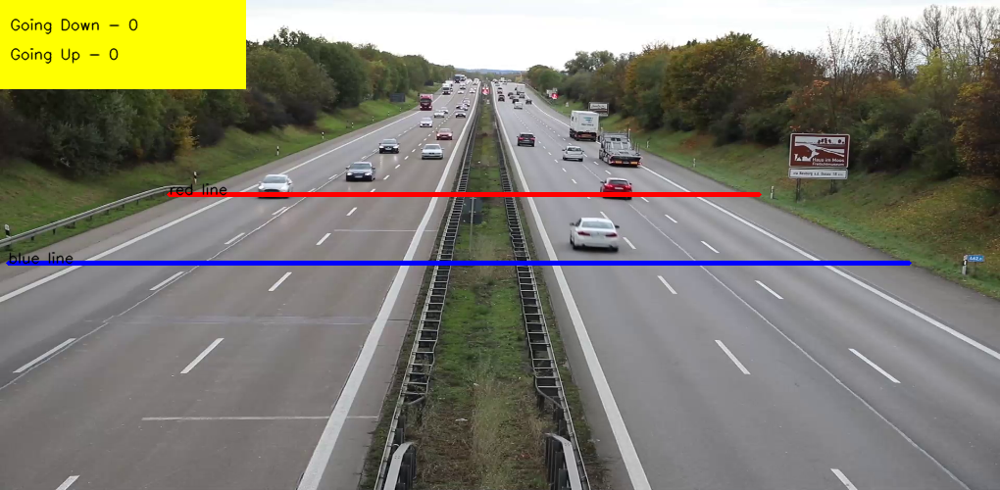


0: 320x640 9 cars, 2 trucks, 12.2ms
Speed: 2.6ms preprocess, 12.2ms inference, 1.7ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   258.702057  178.546967  297.100891  204.756439  0.858481  2.0
1   578.311768  217.715652  629.673096  252.837677  0.823349  2.0
2   610.297119  181.388763  644.055908  202.246063  0.806266  2.0
3   427.788116  146.792221  451.984833  164.095596  0.793048  2.0
4   579.765503  112.517929  612.009216  143.735168  0.656784  7.0
5   609.499451  134.564362  652.795654  170.482147  0.601804  7.0
6   571.935425  148.475357  595.260742  164.525604  0.569650  2.0
7   350.294952  165.120773  381.175598  186.040604  0.558332  2.0
8   443.470032  130.875046  463.387543  145.060135  0.414608  2.0
9   383.803314  141.746140  407.834229  157.048889  0.402381  2.0
10  526.153137  135.755295  546.177917  149.716751  0.392514  2.0


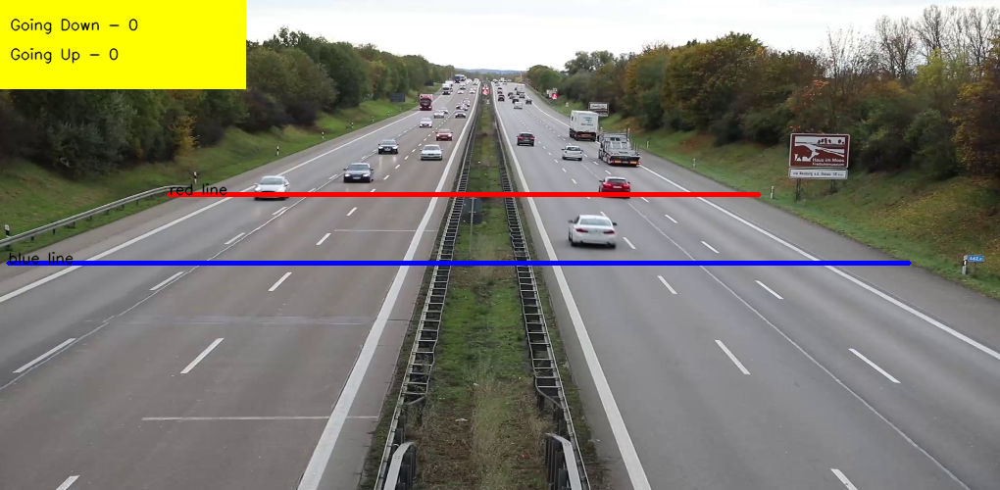


0: 320x640 9 cars, 2 trucks, 11.5ms
Speed: 2.6ms preprocess, 11.5ms inference, 3.6ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   253.877502  180.231216  292.811249  206.192551  0.850847  2.0
1   576.642395  215.193161  628.026245  250.027069  0.801805  2.0
2   427.113342  147.473282  451.157806  165.332443  0.801595  2.0
3   608.300598  180.298859  643.211365  200.781006  0.736419  2.0
4   579.716187  112.391747  611.936890  143.734741  0.671820  7.0
5   348.147522  166.415604  379.822754  187.881592  0.654025  2.0
6   571.663635  148.550598  593.639587  163.612976  0.573057  2.0
7   443.032501  131.454758  462.143677  145.719376  0.535073  2.0
8   609.249451  133.904083  652.140259  169.861298  0.534928  7.0
9   525.798889  134.651505  546.153625  149.282242  0.527932  2.0
10  382.703491  144.467789  406.139343  157.926865  0.491675  2.0


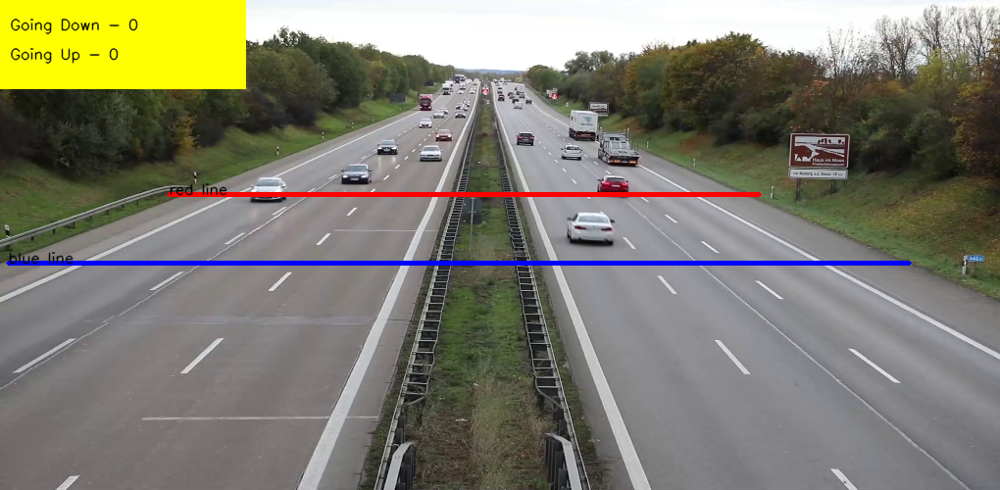


0: 320x640 9 cars, 2 trucks, 13.4ms
Speed: 2.5ms preprocess, 13.4ms inference, 1.8ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   250.177231  182.055344  289.741119  208.027420  0.838930  2.0
1   575.576416  212.943832  624.909119  246.633789  0.796711  2.0
2   426.645813  148.048492  451.165680  166.287277  0.781051  2.0
3   606.836853  178.388504  641.440125  199.533707  0.763241  2.0
4   579.320557  112.781113  611.735718  143.708237  0.686991  7.0
5   344.662018  167.456421  378.186188  189.442398  0.683538  2.0
6   571.322815  146.818146  593.414307  163.180420  0.609349  2.0
7   382.241577  144.707520  405.538116  159.120895  0.535541  2.0
8   525.618164  134.138107  545.614563  148.739532  0.472608  2.0
9   442.527283  131.673203  462.308105  145.679474  0.459160  2.0
10  608.384888  135.053101  652.165344  168.593063  0.375589  7.0


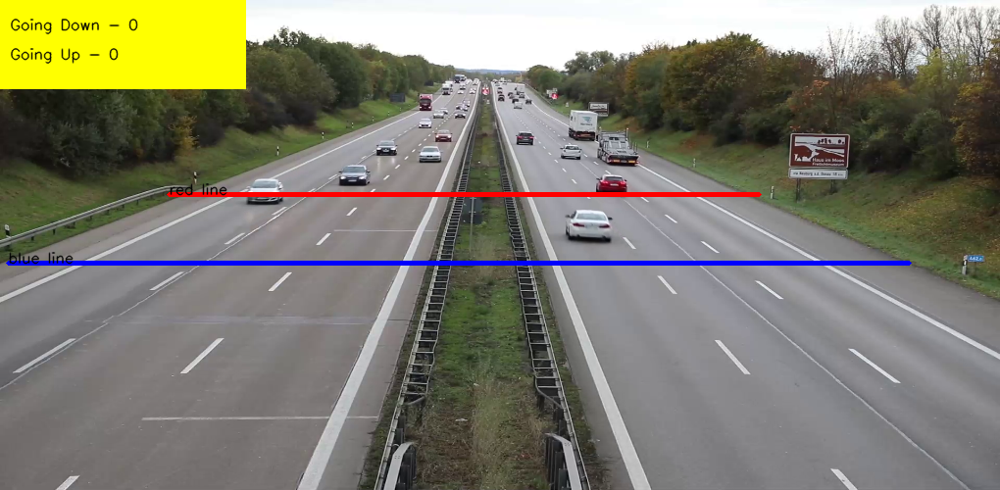


0: 320x640 9 cars, 2 trucks, 15.9ms
Speed: 2.6ms preprocess, 15.9ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   606.250488  177.769363  638.515137  198.496231  0.832693  2.0
1   246.477463  183.663345  287.117218  210.713028  0.824240  2.0
2   574.744202  210.157608  623.150940  243.278412  0.819548  2.0
3   425.839355  148.257660  450.402710  167.689560  0.762668  2.0
4   341.746765  167.403580  374.963074  191.951614  0.725388  2.0
5   570.479065  144.867172  592.824585  162.795868  0.669010  2.0
6   578.909180  112.444954  611.205933  143.654205  0.643344  7.0
7   381.578827  145.594101  404.486115  159.973465  0.607775  2.0
8   607.993835  134.628586  651.561829  168.711197  0.492290  7.0
9   442.132935  130.679932  462.484772  146.174744  0.416372  2.0
10  524.938904  133.096207  545.005676  148.829529  0.415009  2.0


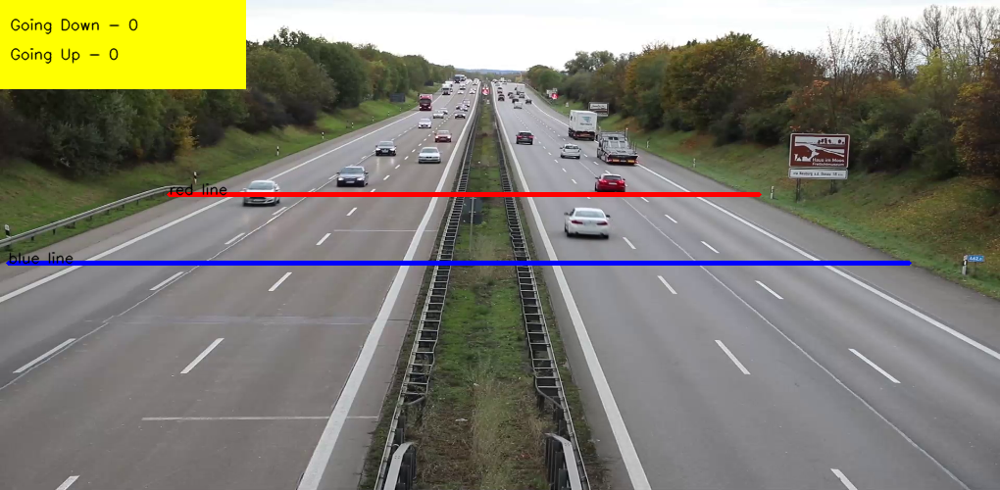


0: 320x640 9 cars, 2 trucks, 13.6ms
Speed: 2.5ms preprocess, 13.6ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   573.262024  207.553406  621.061951  239.979370  0.853596  2.0
1   242.465607  184.755783  284.029846  212.836349  0.831861  2.0
2   604.818359  176.903580  637.478577  197.730011  0.826417  2.0
3   339.507721  168.475891  372.645874  192.407730  0.765525  2.0
4   424.228363  149.863388  450.272217  168.736618  0.763700  2.0
5   569.596924  145.119461  592.276245  162.510376  0.691648  2.0
6   381.360474  145.766159  404.433746  159.879608  0.683539  2.0
7   578.391541  112.295853  610.817383  143.611938  0.617584  7.0
8   607.733643  133.791580  649.942505  168.873062  0.600554  7.0
9   441.477112  131.451523  462.426392  146.873901  0.571663  2.0
10  524.685791  133.383881  544.475159  148.239014  0.412119  2.0


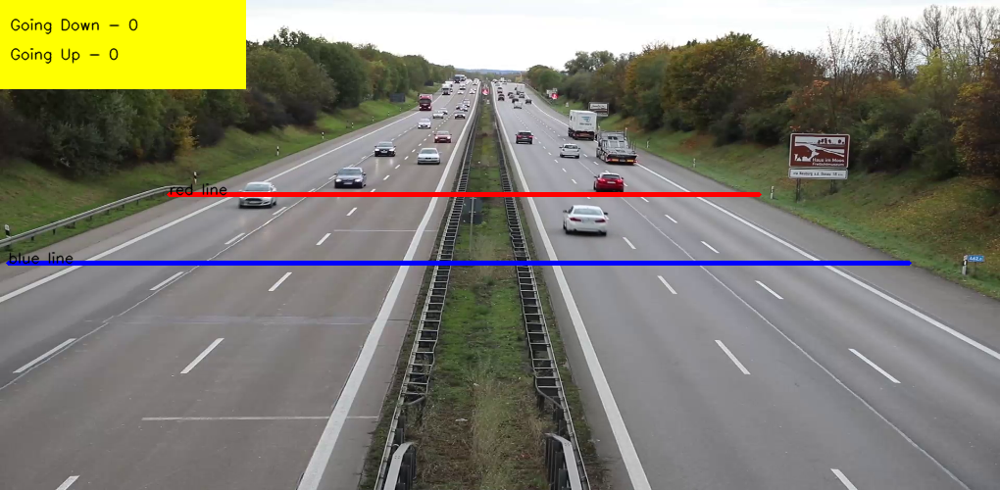


0: 320x640 9 cars, 2 trucks, 11.0ms
Speed: 2.8ms preprocess, 11.0ms inference, 2.0ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   237.410919  186.742523  280.498505  214.879120  0.846121  2.0
1   572.472778  205.531830  619.845825  237.536255  0.843561  2.0
2   603.427490  176.124329  636.390991  196.457581  0.815484  2.0
3   423.697174  150.565384  449.704956  169.910370  0.737635  2.0
4   337.760223  171.338074  370.719543  193.984024  0.703751  2.0
5   569.770691  145.315857  591.413147  162.073425  0.680412  2.0
6   379.159668  145.468719  403.194855  160.578217  0.654197  2.0
7   578.550049  111.388260  609.718811  143.199005  0.623481  7.0
8   441.296570  132.093491  462.175446  147.304291  0.595487  2.0
9   606.270447  133.174408  648.957336  167.792358  0.542971  7.0
10  524.431641  132.982498  544.260620  147.588974  0.432106  2.0


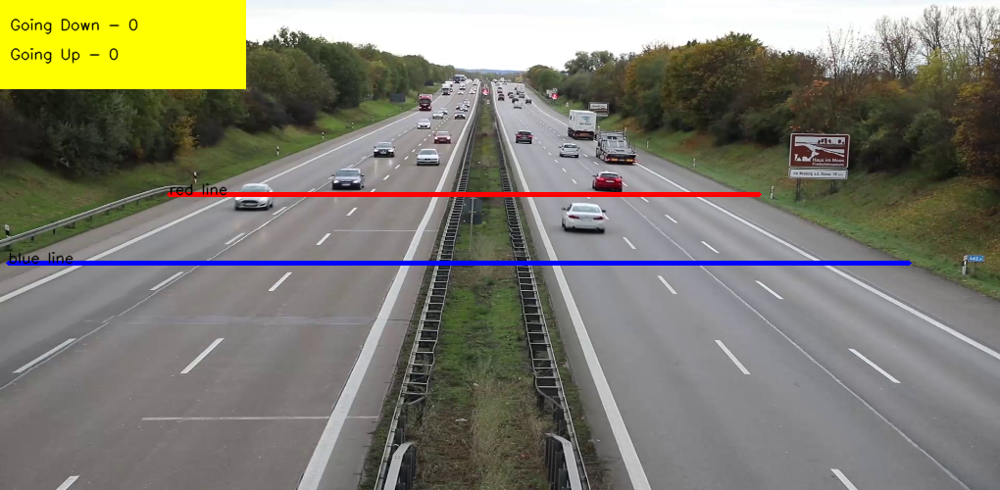


0: 320x640 9 cars, 2 trucks, 16.0ms
Speed: 2.7ms preprocess, 16.0ms inference, 4.6ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   570.964050  202.974045  618.225952  234.520782  0.827445  2.0
1   233.977310  188.402893  276.459442  216.689713  0.821167  2.0
2   601.715271  175.453995  634.122864  195.094604  0.746269  2.0
3   335.061279  172.289780  369.734009  195.148972  0.720864  2.0
4   422.858734  151.246140  448.789246  170.963242  0.696929  2.0
5   570.288940  144.409149  591.678955  161.294662  0.685736  2.0
6   378.634277  146.820374  401.932983  161.702057  0.672932  2.0
7   578.103821  111.991920  609.114807  142.897919  0.665482  7.0
8   605.959900  133.204315  648.511414  167.003952  0.566648  7.0
9   441.246765  132.621155  462.329620  148.082275  0.508511  2.0
10  524.544189  132.856140  543.682922  147.401443  0.337630  2.0


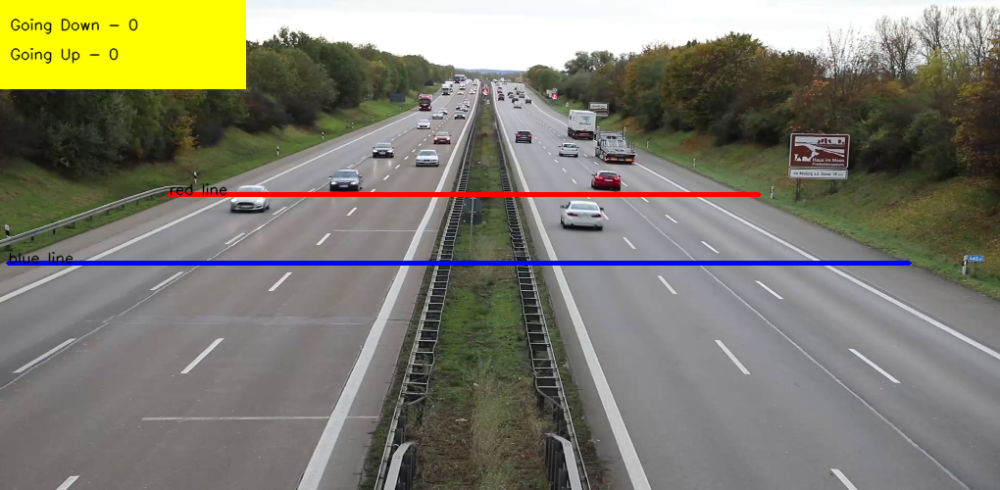


0: 320x640 9 cars, 2 trucks, 11.1ms
Speed: 3.1ms preprocess, 11.1ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   228.987747  190.112350  272.406433  219.015610  0.860674  2.0
1   569.956177  200.986206  616.431824  232.061020  0.800847  2.0
2   577.865417  111.960983  608.796448  142.592453  0.742588  7.0
3   332.809753  173.520432  367.686859  197.854401  0.731340  2.0
4   600.843262  174.517593  631.595154  193.149338  0.730329  2.0
5   378.626770  147.655838  401.132935  162.464325  0.685647  2.0
6   569.730225  143.982239  591.084351  160.349106  0.673338  2.0
7   422.460876  152.261688  448.590424  172.090759  0.650612  2.0
8   605.856201  132.691406  647.077576  166.834366  0.577010  7.0
9   440.475189  134.721436  462.678528  149.085266  0.490433  2.0
10  524.483643  132.705566  543.183716  146.931763  0.391397  2.0


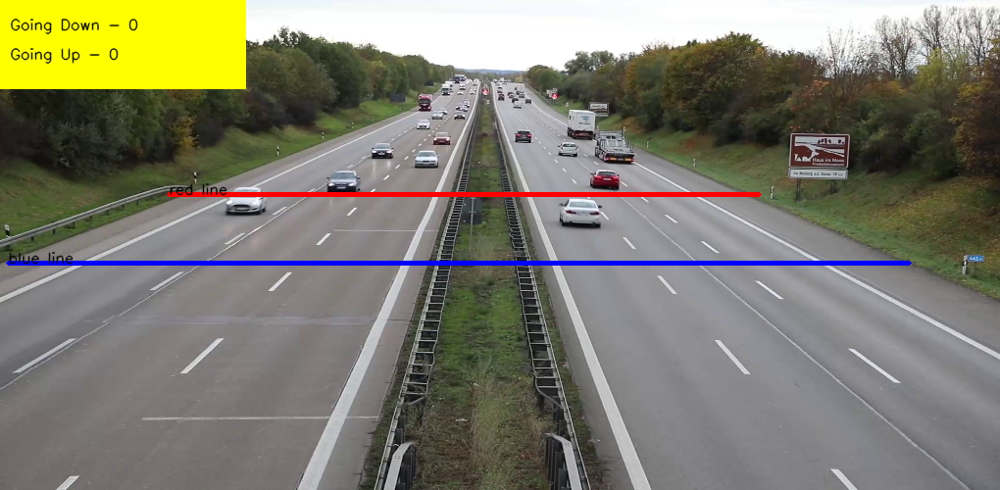


0: 320x640 9 cars, 2 trucks, 10.9ms
Speed: 2.7ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   225.344131  192.326935  267.615265  221.344772  0.854036  2.0
1   568.656128  198.599030  614.064331  229.667389  0.809588  2.0
2   330.428345  174.472260  364.636383  198.333862  0.782711  2.0
3   599.913818  172.732239  631.038818  191.871735  0.770684  2.0
4   577.683716  111.527702  608.690430  142.421249  0.721350  7.0
5   376.865723  147.916855  399.709930  163.127960  0.698327  2.0
6   604.924500  132.705063  646.168030  166.866577  0.694725  7.0
7   421.040405  152.285370  447.187958  173.483337  0.657973  2.0
8   568.847351  143.729660  590.135376  159.981781  0.651276  2.0
9   440.411774  136.004929  461.908234  149.976120  0.542756  2.0
10  524.522766  132.215729  542.614075  145.521317  0.425065  2.0


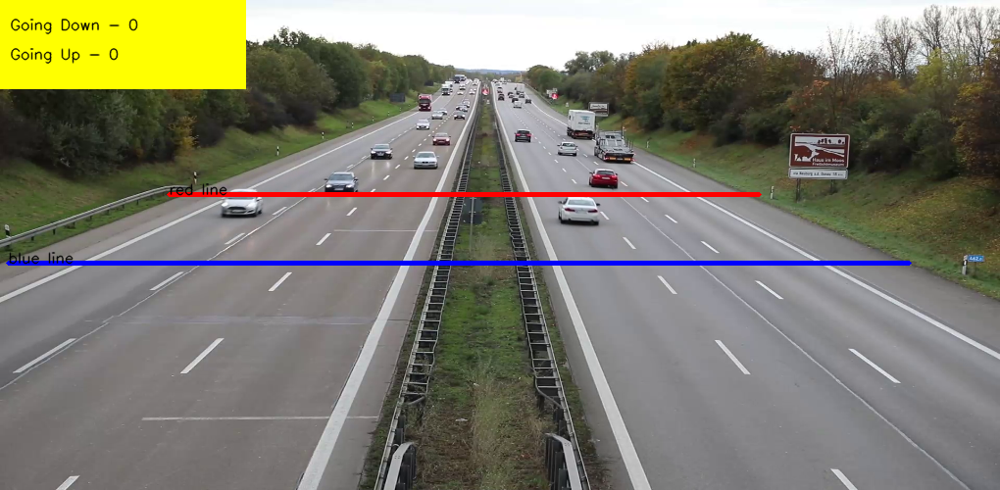


0: 320x640 9 cars, 2 trucks, 14.7ms
Speed: 2.6ms preprocess, 14.7ms inference, 5.3ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   219.966446  193.139481  264.670624  224.245316  0.849085  2.0
1   327.615417  175.243439  362.944275  199.994904  0.805707  2.0
2   567.856140  196.131912  611.457031  226.641113  0.801696  2.0
3   598.790283  172.254715  630.016663  190.634827  0.744542  2.0
4   577.288818  110.358910  608.272278  141.589783  0.709370  7.0
5   604.894348  132.778748  646.095886  166.740540  0.666664  7.0
6   376.317535  148.560226  398.957611  163.365875  0.638590  2.0
7   419.373566  152.630981  446.409149  174.768448  0.631999  2.0
8   440.440155  136.170319  460.441040  149.605576  0.482657  2.0
9   568.203674  143.371429  589.916077  159.549316  0.430240  2.0
10  524.180115  131.694397  542.418396  144.354141  0.412040  2.0


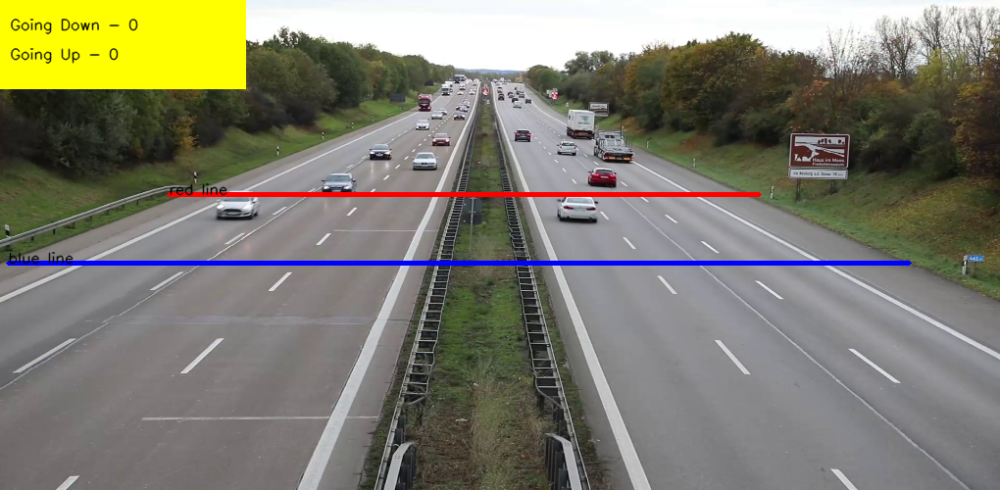


0: 320x640 9 cars, 2 trucks, 18.4ms
Speed: 2.7ms preprocess, 18.4ms inference, 2.1ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   214.141235  195.217087  260.621277  226.881332  0.864530  2.0
1   566.832764  195.298035  609.178223  223.785065  0.800548  2.0
2   325.302979  177.346024  361.660370  201.970657  0.755158  2.0
3   597.654968  171.107452  628.843506  189.589478  0.750234  2.0
4   577.242432  111.161957  608.306152  142.348114  0.704220  7.0
5   418.115326  153.540665  446.093872  175.602203  0.640004  2.0
6   375.524078  148.327484  397.954102  163.412094  0.638073  2.0
7   605.013306  132.495209  645.850952  165.224152  0.593729  7.0
8   437.302582  136.960190  460.112732  149.772812  0.449429  2.0
9   567.592529  143.506149  588.404663  159.010529  0.444121  2.0
10  523.941467  130.923920  542.194092  144.179184  0.338920  2.0


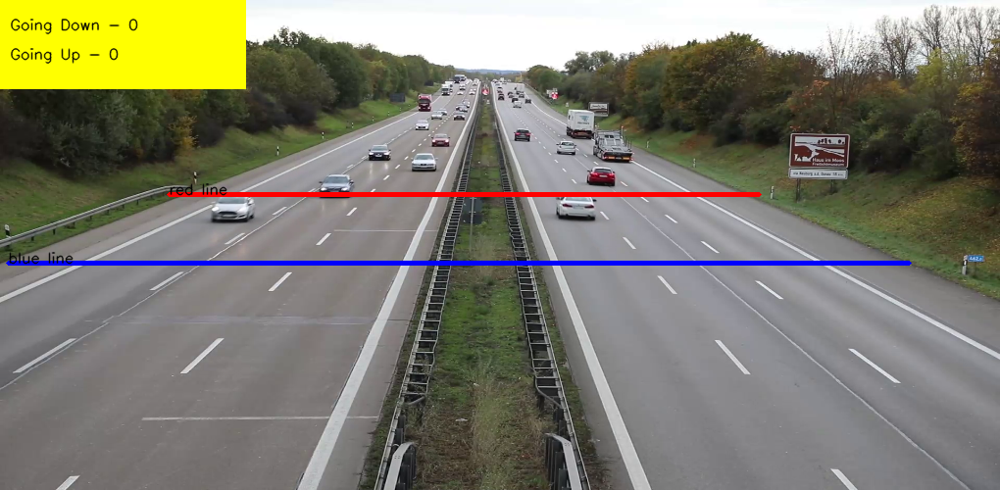


0: 320x640 9 cars, 2 trucks, 16.0ms
Speed: 5.7ms preprocess, 16.0ms inference, 1.9ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   209.497559  197.640076  255.603714  228.808090  0.847996  2.0
1   564.994690  193.470001  606.959778  221.783295  0.774990  2.0
2   322.358521  178.411407  359.466217  203.820892  0.765636  2.0
3   596.684875  170.004776  626.776611  188.382797  0.704057  2.0
4   417.125244  154.633362  445.642914  177.352615  0.700419  2.0
5   577.151794  110.483337  607.923523  141.461945  0.689270  7.0
6   373.029694  148.526016  396.828064  164.139877  0.646506  2.0
7   603.022522  131.872314  644.984131  165.109741  0.590705  7.0
8   566.714111  142.363495  588.432678  158.385178  0.473310  2.0
9   437.644989  137.825607  460.219727  150.117126  0.396582  2.0
10  523.541321  130.290710  541.930542  143.727249  0.308077  2.0


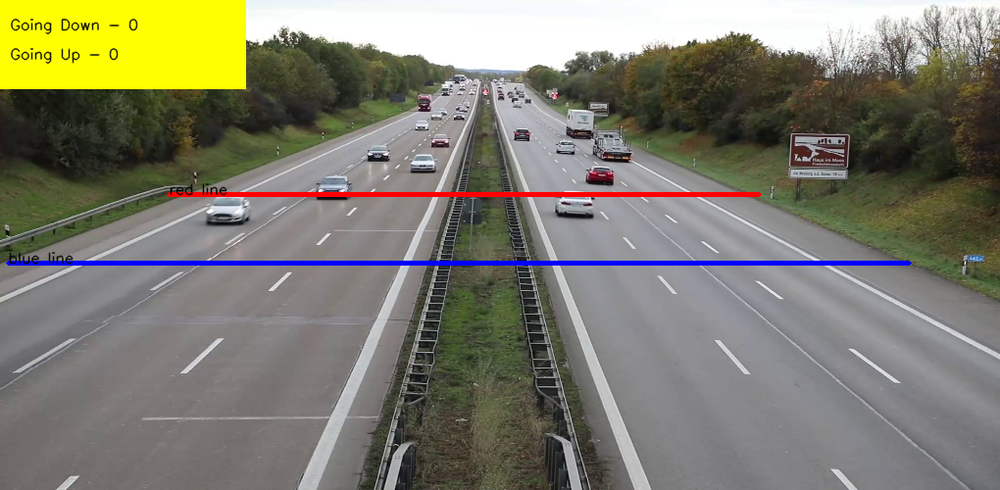


0: 320x640 9 cars, 2 trucks, 11.4ms
Speed: 2.6ms preprocess, 11.4ms inference, 2.0ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   203.110046  200.127960  251.692078  232.011658  0.819275  2.0
1   318.849762  179.746704  356.725891  205.873627  0.818927  2.0
2   564.106934  191.574158  605.515442  219.544662  0.815061  2.0
3   415.513062  155.783661  445.339172  179.237686  0.757571  2.0
4   596.005432  168.908966  624.856689  188.065094  0.687075  2.0
5   576.881348  111.027901  606.951721  141.181625  0.664588  7.0
6   372.347473  149.433548  396.367249  165.471970  0.637623  2.0
7   602.960144  132.077560  644.219238  164.751038  0.545891  7.0
8   566.983643  140.593811  588.044861  157.327026  0.453660  2.0
9   436.653839  138.777557  459.798615  151.093811  0.388282  2.0
10  523.289551  130.658615  541.839233  143.190582  0.317075  2.0


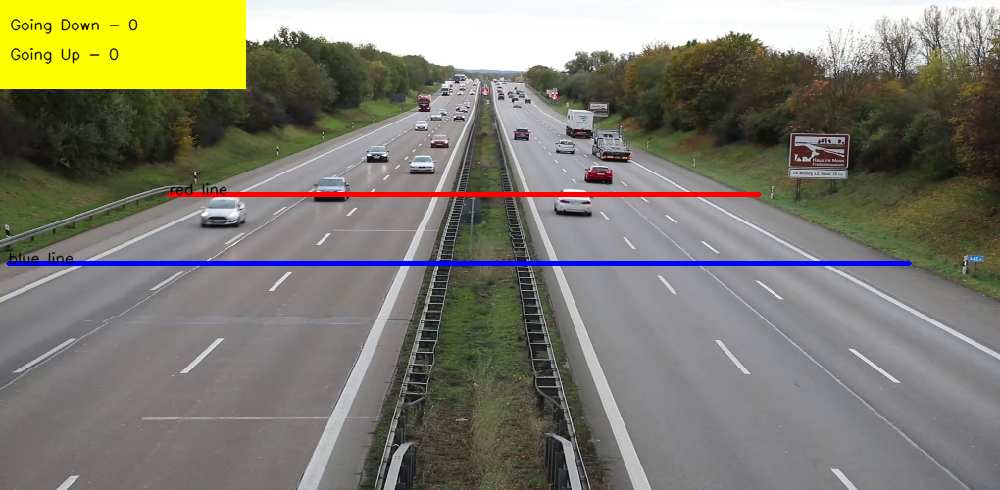


0: 320x640 9 cars, 2 trucks, 10.7ms
Speed: 2.5ms preprocess, 10.7ms inference, 1.9ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   563.659180  188.635696  604.151367  217.287979  0.832249  2.0
1   198.037659  202.197647  247.623550  235.216888  0.816298  2.0
2   314.533020  180.187012  353.925751  206.942200  0.779165  2.0
3   414.758759  156.859436  444.575623  179.860764  0.761076  2.0
4   594.495911  166.530609  623.856323  186.960495  0.726140  2.0
5   576.797302  110.763664  606.460938  141.262405  0.659423  7.0
6   371.314667  148.811310  396.105103  166.135681  0.621891  2.0
7   602.783875  131.457825  644.573303  164.081451  0.532916  7.0
8   565.182007  140.423172  586.908142  156.379837  0.500163  2.0
9   437.106262  139.581161  459.650879  152.770432  0.391293  2.0
10  523.581787  129.967392  541.943970  142.941788  0.262675  2.0


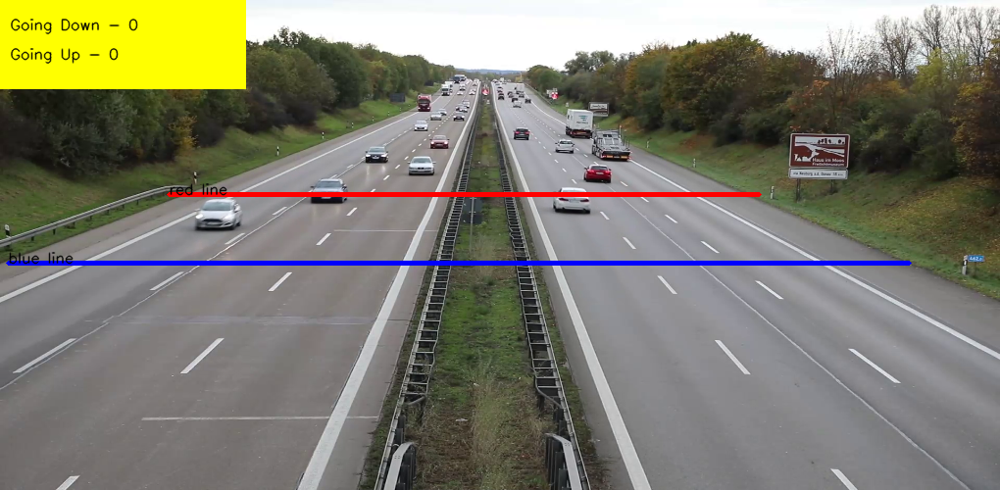


0: 320x640 8 cars, 2 trucks, 10.6ms
Speed: 2.5ms preprocess, 10.6ms inference, 4.8ms postprocess per image at shape (1, 3, 320, 640)
            0           1           2           3         4    5
0  192.229675  204.640289  242.311752  238.237930  0.835304  2.0
1  563.189453  187.436264  603.025818  214.945557  0.822558  2.0
2  414.243195  159.161804  443.755005  180.604752  0.726740  2.0
3  593.470032  167.351547  623.285156  186.275238  0.718382  2.0
4  576.514893  110.772141  606.051575  141.229996  0.674464  7.0
5  312.691772  181.357468  351.751190  209.480408  0.661876  2.0
6  369.639893  148.977661  395.321167  167.006042  0.595982  2.0
7  602.077515  131.026657  643.515259  163.814560  0.577720  7.0
8  564.339722  140.346893  586.253235  156.051453  0.472145  2.0
9  437.423431  139.029694  458.872314  153.651932  0.378784  2.0


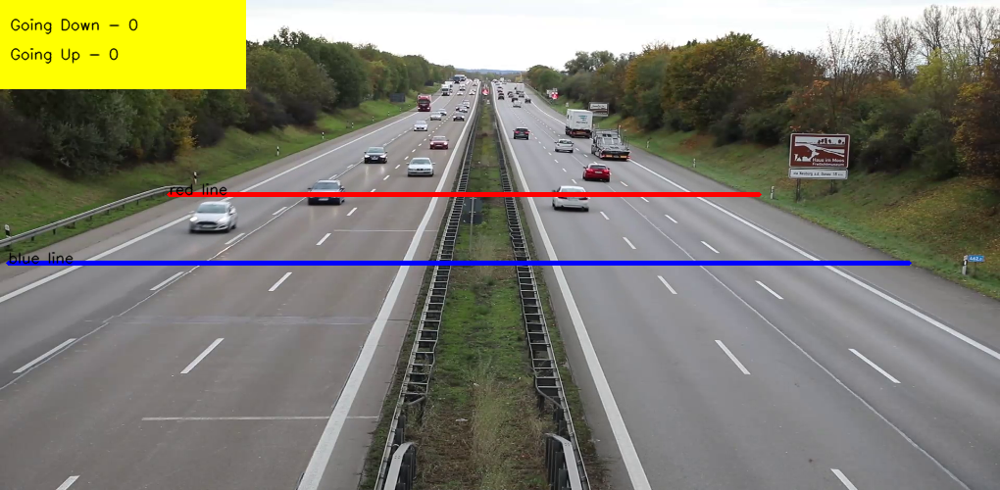


0: 320x640 8 cars, 3 trucks, 14.9ms
Speed: 2.5ms preprocess, 14.9ms inference, 1.8ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   185.545715  206.795700  237.030289  240.994354  0.848378  2.0
1   561.680725  185.866699  602.108521  213.367340  0.830538  2.0
2   592.835144  165.945496  623.011292  185.244568  0.753325  2.0
3   309.747711  184.454941  349.089142  210.850769  0.721750  2.0
4   576.166321  110.698433  605.506836  141.050262  0.684127  7.0
5   413.721313  160.308350  442.202576  181.622223  0.638865  2.0
6   369.080261  149.444290  395.003357  167.659821  0.593638  2.0
7   600.865417  131.681305  642.750366  163.684265  0.574988  7.0
8   563.886658  140.352692  585.257141  155.848938  0.424246  2.0
9   437.357727  138.764542  458.375305  154.426071  0.402781  2.0
10  424.482910   95.257378  440.599396  114.053635  0.252876  7.0


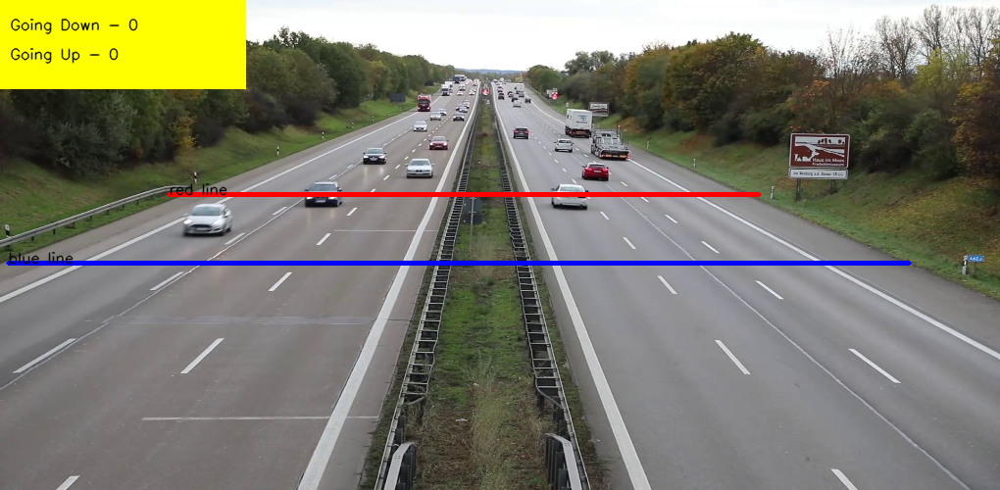


0: 320x640 8 cars, 2 trucks, 10.8ms
Speed: 2.9ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 320, 640)
            0           1           2           3         4    5
0  560.893860  184.246048  601.461853  211.199493  0.812220  2.0
1  179.468002  209.237076  232.475372  244.565338  0.804078  2.0
2  306.655182  186.492233  347.277374  213.359436  0.769578  2.0
3  592.308044  165.824127  621.763062  184.263092  0.734550  2.0
4  412.287964  161.691849  441.056213  184.239258  0.725181  2.0
5  601.022095  130.682434  641.945007  163.414337  0.679373  7.0
6  575.967407  110.609718  605.110779  140.961685  0.669731  7.0
7  368.253876  150.921844  394.189453  167.889633  0.535145  2.0
8  563.596863  140.611694  584.870911  155.725174  0.411737  2.0
9  436.470917  140.016739  458.666779  155.673019  0.367644  2.0


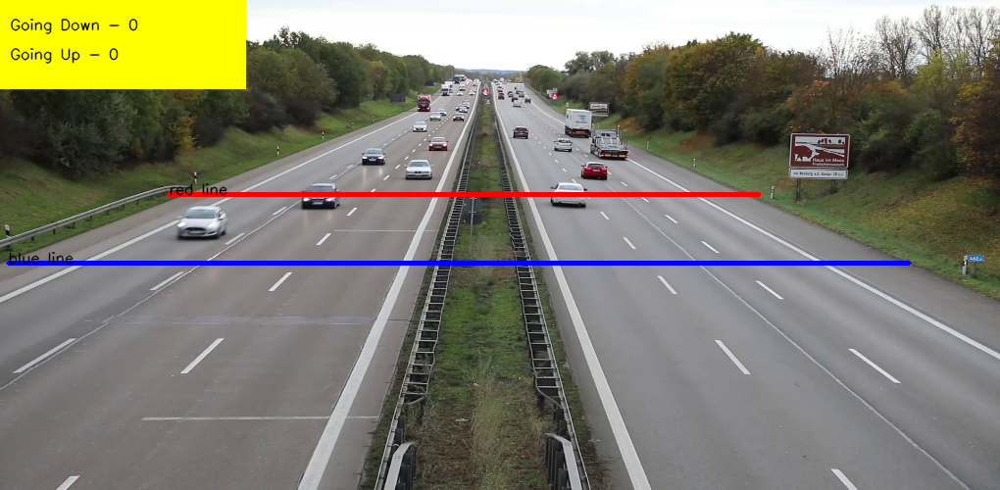


0: 320x640 8 cars, 2 trucks, 19.4ms
Speed: 4.2ms preprocess, 19.4ms inference, 2.7ms postprocess per image at shape (1, 3, 320, 640)
            0           1           2           3         4    5
0  561.024231  182.902954  601.226135  209.728271  0.836608  2.0
1  172.355179  211.962433  227.376022  248.395050  0.823647  2.0
2  410.840332  163.158051  440.233856  185.263550  0.751474  2.0
3  600.976746  130.257614  641.130005  163.215317  0.749387  7.0
4  303.649017  187.914673  344.620972  215.455048  0.745551  2.0
5  575.808044  110.575768  604.168884  140.906235  0.703574  7.0
6  590.728027  164.827377  620.577576  183.438721  0.663128  2.0
7  366.609375  151.193390  392.829773  168.804794  0.476479  2.0
8  435.978271  141.315186  458.471710  155.841949  0.459213  2.0
9  563.511719  139.627411  585.151672  154.994614  0.384560  2.0


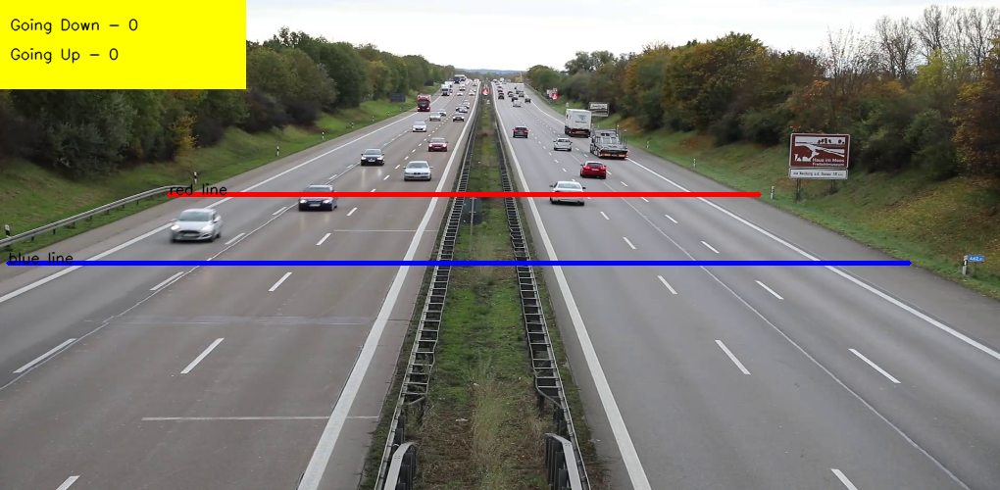


0: 320x640 9 cars, 2 trucks, 14.6ms
Speed: 2.6ms preprocess, 14.6ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   559.528320  181.373642  600.001282  207.301361  0.820679  2.0
1   165.722839  214.182755  222.880356  251.710632  0.804551  2.0
2   410.114960  164.460022  440.228882  186.779419  0.804226  2.0
3   300.317993  189.586014  341.003052  217.879547  0.763086  2.0
4   575.482727  110.102524  604.146790  140.775116  0.738260  7.0
5   600.506531  130.265671  639.548645  162.417801  0.637814  7.0
6   589.968994  164.103195  618.810364  181.785889  0.617494  2.0
7   435.341034  142.529083  457.742615  156.443619  0.473560  2.0
8   365.646912  151.787216  392.024048  169.557465  0.433690  2.0
9   563.160156  139.493057  584.880249  154.665634  0.384929  2.0
10  522.162903  127.360619  539.137268  140.772964  0.373203  2.0


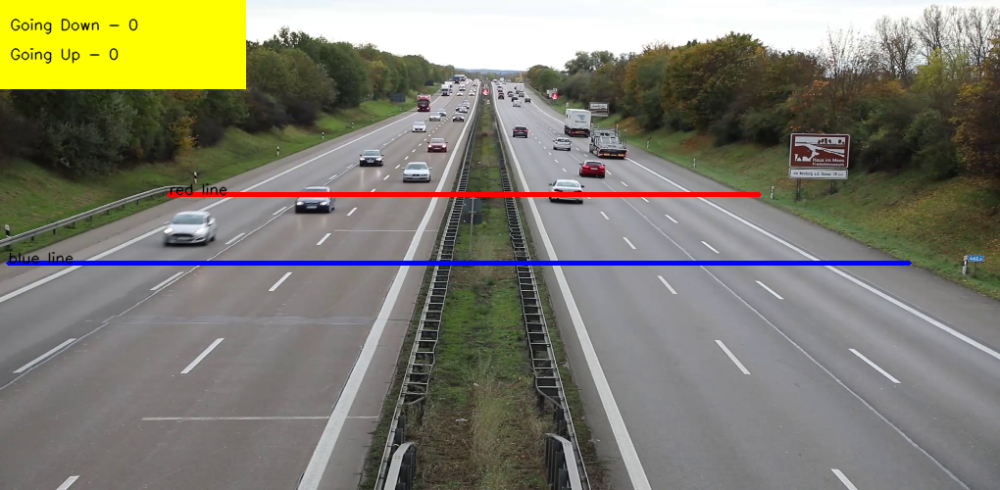


0: 320x640 8 cars, 2 trucks, 17.8ms
Speed: 2.6ms preprocess, 17.8ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)
            0           1           2           3         4    5
0  559.217346  179.227814  595.643555  206.044571  0.824963  2.0
1  158.583328  217.611130  216.371994  254.572723  0.823383  2.0
2  408.638123  165.603882  439.842316  187.939240  0.771696  2.0
3  574.737671  109.961945  603.289368  140.809677  0.698516  7.0
4  588.438232  162.323013  617.579041  180.585815  0.675436  2.0
5  296.798187  191.416794  338.266785  219.980743  0.674793  2.0
6  435.185822  141.805374  457.081299  156.119354  0.574019  2.0
7  364.818359  153.844681  390.119812  170.914520  0.491380  2.0
8  600.176819  130.421509  639.680542  162.168488  0.480340  7.0
9  522.071289  127.248253  538.977295  140.435211  0.420884  2.0


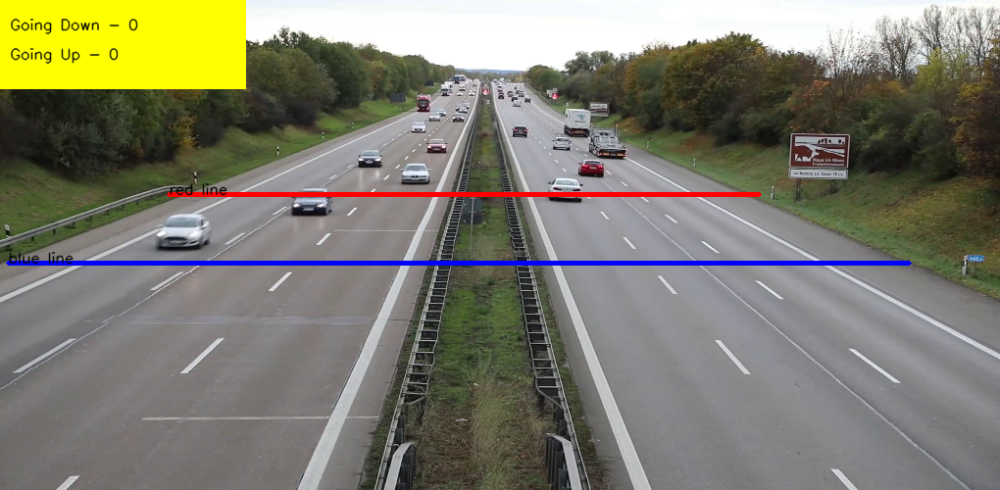


0: 320x640 9 cars, 2 trucks, 10.6ms
Speed: 5.6ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 320, 640)
             0           1           2           3         4    5
0   150.055450  219.732590  209.836823  258.923431  0.831381  2.0
1   557.653137  178.631668  594.090149  204.471634  0.823174  2.0
2   407.051514  165.990356  438.584808  189.370499  0.762220  2.0
3   293.250824  192.650467  336.592590  222.716736  0.704847  2.0
4   587.823669  161.775650  616.489197  180.019043  0.699143  2.0
5   574.518494  109.836769  602.722534  140.667328  0.692960  7.0
6   434.494293  142.765762  456.746887  157.309097  0.653455  2.0
7   363.108063  155.123093  389.221375  171.828094  0.594884  2.0
8   599.791748  130.123672  638.538818  161.476288  0.553910  7.0
9   521.995361  127.264328  538.951294  140.115784  0.353946  2.0
10  562.372559  139.238129  583.743835  153.806427  0.347461  2.0


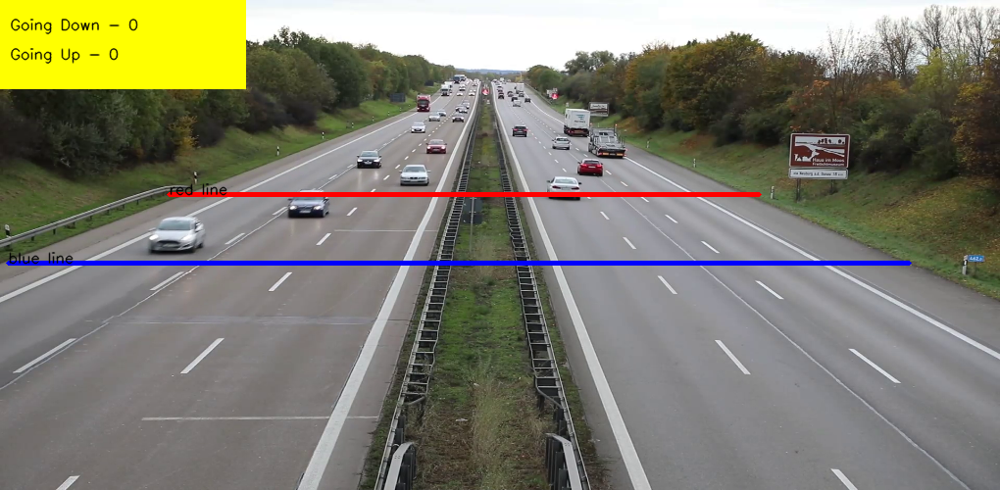


0: 320x640 9 cars, 2 trucks, 26.6ms
Speed: 2.6ms preprocess, 26.6ms inference, 5.7ms postprocess per image at shape (1, 3, 320, 640)


In [ ]:
while True:
    ret, frame = cap.read()
    if not ret:
        break
    count += 1
    frame=cv2.resize(frame,(1020,500))



    results=model.predict(frame)
    a = results[0].boxes.data
    a = a.detach().cpu().numpy()
    px = pd.DataFrame(a).astype("float")
    print(px)

    list = []
    for index, row in px.iterrows():
        x1 = int(row[0])
        y1 = int(row[1])
        x2 = int(row[2])
        y2 = int(row[3])
        d = int(row[5])
        c = class_list[d]
        if 'car' in c:
            list.append([x1, y1, x2, y2])
            # print(c)


    bbox_id = tracker.update(list)
    for bbox in bbox_id:
        x3, y3, x4, y4, id = bbox
        cx = int(x3 + x4) // 2
        cy = int(y3 + y4) // 2
        # cv2.circle(frame, (cx, cy), 4, (0, 0, 255), -1)
        # cv2.rectangle(frame, (x3, y3), (x4, y4), (0, 0, 255), 2)
        if red_line_y<(cy+offset) and red_line_y > (cy-offset):
           down[id]=time.time()   # current time when vehichle touch the first line
        if id in down:

           if blue_line_y<(cy+offset) and blue_line_y > (cy-offset):
             elapsed_time=time.time() - down[id]  # current time when vehicle touch the second line. Also we a re minusing the previous time ( current time of line 1)
             if counter_down.count(id)==0:
                counter_down.append(id)
                distance = 10 # meters
                a_speed_ms = distance / elapsed_time
                a_speed_kh = a_speed_ms * 3.6  # this will give kilometers per hour for each vehicle. This is the condition for going downside
                cv2.circle(frame,(cx,cy),4,(0,0,255),-1)
                cv2.rectangle(frame, (x3, y3), (x4, y4), (0, 255, 0), 2)  # Draw bounding box
                cv2.putText(frame,str(id),(x3,y3),cv2.FONT_HERSHEY_COMPLEX,0.6,(255,255,255),1)
                cv2.putText(frame,str(int(a_speed_kh))+'Km/h',(x4,y4 ),cv2.FONT_HERSHEY_COMPLEX,0.8,(0,255,255),2)


        #####going UP blue line#####
        if blue_line_y<(cy+offset) and blue_line_y > (cy-offset):
           up[id]=time.time()
        if id in up:

           if red_line_y<(cy+offset) and red_line_y > (cy-offset):
             elapsed1_time=time.time() - up[id]
             # formula of speed= distance/time
             if counter_up.count(id)==0:
                counter_up.append(id)
                distance1 = 10 # meters  (Distance between the 2 lines is 10 meters )
                a_speed_ms1 = distance1 / elapsed1_time
                a_speed_kh1 = a_speed_ms1 * 3.6
                cv2.circle(frame,(cx,cy),4,(0,0,255),-1)
                cv2.rectangle(frame, (x3, y3), (x4, y4), (0, 255, 0), 2)  # Draw bounding box
                cv2.putText(frame,str(id),(x3,y3),cv2.FONT_HERSHEY_COMPLEX,0.6,(255,255,255),1)
                cv2.putText(frame,str(int(a_speed_kh1))+'Km/h',(x4,y4),cv2.FONT_HERSHEY_COMPLEX,0.8,(0,255,255),2)




    text_color = (0, 0, 0)  # Black color for text
    yellow_color = (0, 255, 255)  # Yellow color for background
    red_color = (0, 0, 255)  # Red color for lines
    blue_color = (255, 0, 0)  # Blue color for lines
    green_color = (0, 255, 0)  # Green color for lines

    cv2.rectangle(frame, (0, 0), (250, 90), yellow_color, -1)



# first line
    cv2.line(frame, (172,198),(774,198),red_color,3)
    cv2.putText(frame, ('red line'), (172,198), cv2.FONT_HERSHEY_SIMPLEX, 0.5, text_color, 1, cv2.LINE_AA)

# second line
    cv2.line(frame, (8,268),(927,268),blue_color,3)
    cv2.putText(frame, ('blue line'), (8,268), cv2.FONT_HERSHEY_SIMPLEX, 0.5, text_color, 1, cv2.LINE_AA)


    cv2.putText(frame, ('Going Down - ' + str(len(counter_down))), (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, text_color, 1, cv2.LINE_AA)
    cv2.putText(frame, ('Going Up - ' + str(len(counter_up))), (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 0.5, text_color, 1, cv2.LINE_AA)

    # Save frame
    frame_filename = f'detected_frames/frame_{count}.jpg'
    cv2.imwrite(frame_filename, frame)

    out.write(frame)


    cv2_imshow(frame)
    if cv2.waitKey(1)&0xFF==27:
        break

cap.release()
out.release()
cv2.destroyAllWindows()